In [23]:
from MonaiUNets import UNetHeart_8_4_4, UNetHeart_16_4_8
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt
import nibabel as nib
import torch
import os
import onnx
import scipy.ndimage
import numpy as np

In [24]:
patient_ids = [
    "patient001_frame01", "patient001_frame12",
    "patient002_frame01", "patient002_frame12",
    "patient003_frame01", "patient003_frame15",
    "patient004_frame01", "patient004_frame15",
    "patient005_frame01", "patient005_frame13",
]

all_images = {}
all_labels = {}

for path in patient_ids:
    img_path = f"Task500_ACDC/imagesTr/{path}_0000.nii.gz"
    gt_path = f"Task500_ACDC/labelsTr/{path}.nii.gz"

    img = nib.load(img_path).get_fdata()
    gt = nib.load(gt_path).get_fdata()

    all_images[path] = img
    all_labels[path] = gt

    print(f"✓ Loaded: {path} → image shape = {img.shape}, label shape = {gt.shape}")

✓ Loaded: patient001_frame01 → image shape = (216, 256, 10), label shape = (216, 256, 10)
✓ Loaded: patient001_frame12 → image shape = (216, 256, 10), label shape = (216, 256, 10)
✓ Loaded: patient002_frame01 → image shape = (232, 256, 10), label shape = (232, 256, 10)
✓ Loaded: patient002_frame12 → image shape = (232, 256, 10), label shape = (232, 256, 10)
✓ Loaded: patient003_frame01 → image shape = (256, 256, 10), label shape = (256, 256, 10)
✓ Loaded: patient003_frame15 → image shape = (256, 256, 10), label shape = (256, 256, 10)
✓ Loaded: patient004_frame01 → image shape = (232, 256, 10), label shape = (232, 256, 10)
✓ Loaded: patient004_frame15 → image shape = (232, 256, 10), label shape = (232, 256, 10)
✓ Loaded: patient005_frame01 → image shape = (256, 216, 10), label shape = (256, 216, 10)
✓ Loaded: patient005_frame13 → image shape = (256, 216, 10), label shape = (256, 216, 10)


In [25]:
for path in patient_ids:
    all_images[path] = all_images[path].transpose(2, 0, 1)  # shape: (slices, H, W)
    all_labels[path] = all_labels[path].transpose(2, 0, 1)

    print(f"✓ Transposed: {path} → new image shape = {all_images[path].shape}, label shape = {all_labels[path].shape}")

✓ Transposed: patient001_frame01 → new image shape = (10, 216, 256), label shape = (10, 216, 256)
✓ Transposed: patient001_frame12 → new image shape = (10, 216, 256), label shape = (10, 216, 256)
✓ Transposed: patient002_frame01 → new image shape = (10, 232, 256), label shape = (10, 232, 256)
✓ Transposed: patient002_frame12 → new image shape = (10, 232, 256), label shape = (10, 232, 256)
✓ Transposed: patient003_frame01 → new image shape = (10, 256, 256), label shape = (10, 256, 256)
✓ Transposed: patient003_frame15 → new image shape = (10, 256, 256), label shape = (10, 256, 256)
✓ Transposed: patient004_frame01 → new image shape = (10, 232, 256), label shape = (10, 232, 256)
✓ Transposed: patient004_frame15 → new image shape = (10, 232, 256), label shape = (10, 232, 256)
✓ Transposed: patient005_frame01 → new image shape = (10, 256, 216), label shape = (10, 256, 216)
✓ Transposed: patient005_frame13 → new image shape = (10, 256, 216), label shape = (10, 256, 216)


In [26]:
# load pretrained model
model = UNetHeart_8_4_4()

In [27]:
all_predictions = {}
all_segmentations = {}

for path in patient_ids:
    print(f"\n▶ Performing segmentation for: {path}")

    img = all_images[path] 

    pred = model.predict(img)  
    print(np.shape(pred))

    result = np.argmax(pred, axis=1) 
    print(np.shape(result))

    all_predictions[path] = pred
    all_segmentations[path] = result


▶ Performing segmentation for: patient001_frame01
(10, 4, 216, 256)
(10, 216, 256)

▶ Performing segmentation for: patient001_frame12
(10, 4, 216, 256)
(10, 216, 256)

▶ Performing segmentation for: patient002_frame01
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient002_frame12
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient003_frame01
(10, 4, 256, 256)
(10, 256, 256)

▶ Performing segmentation for: patient003_frame15
(10, 4, 256, 256)
(10, 256, 256)

▶ Performing segmentation for: patient004_frame01
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient004_frame15
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient005_frame01
(10, 4, 256, 216)
(10, 256, 216)

▶ Performing segmentation for: patient005_frame13
(10, 4, 256, 216)
(10, 256, 216)


In [28]:
for path in patient_ids:
    num_slices = img.shape[0]  
    print(num_slices)

10
10
10
10
10
10
10
10
10
10


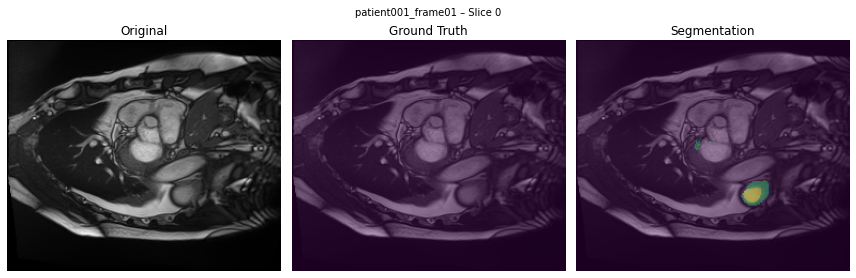

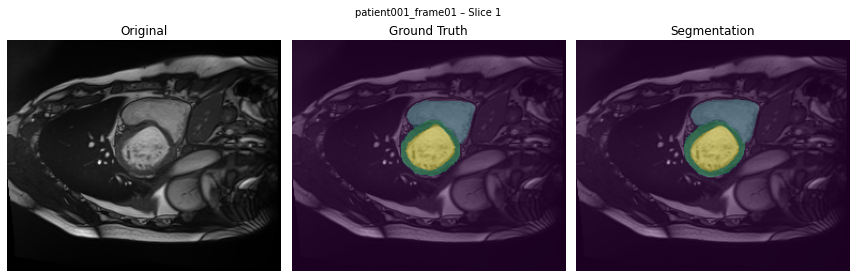

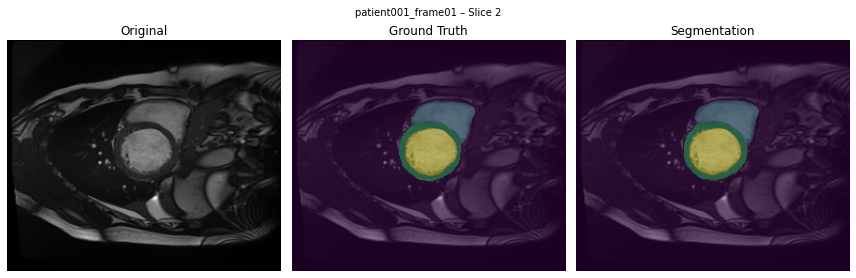

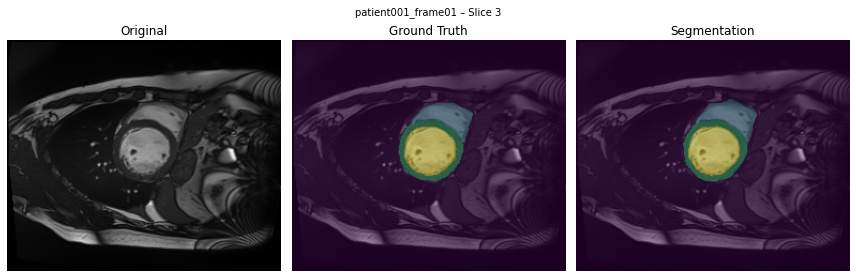

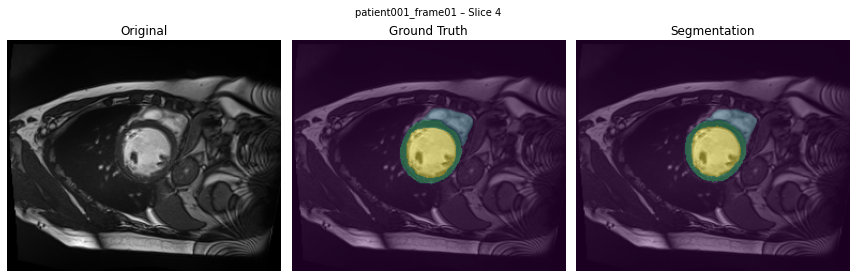

...

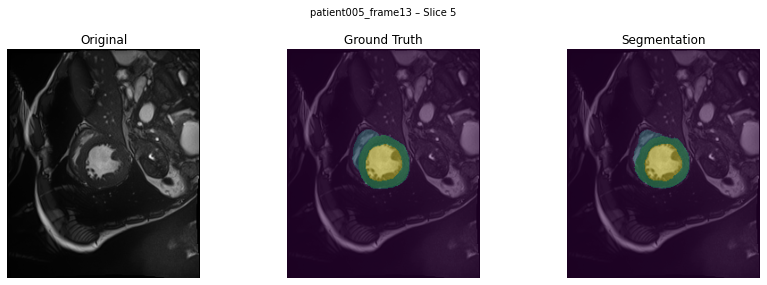

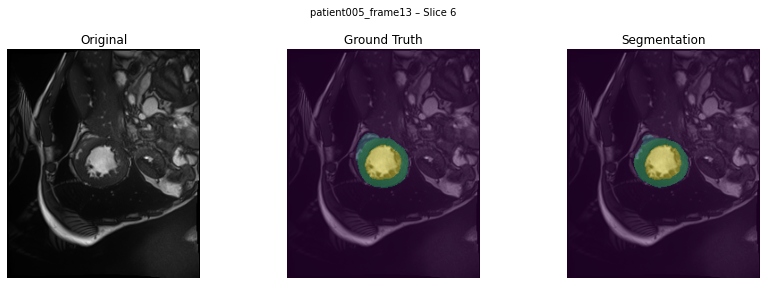

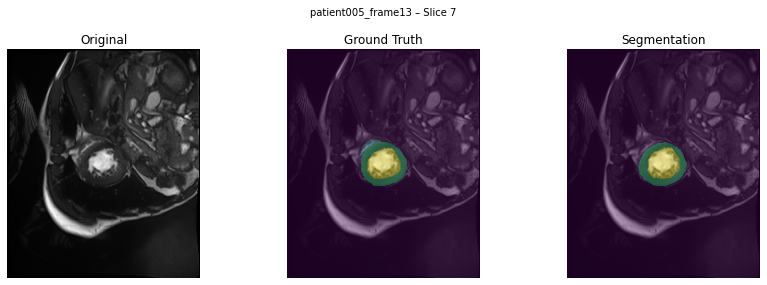

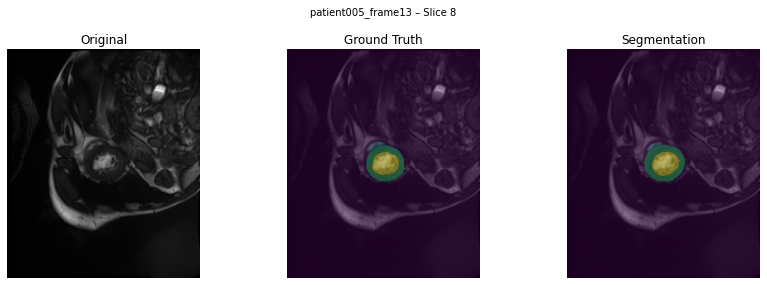

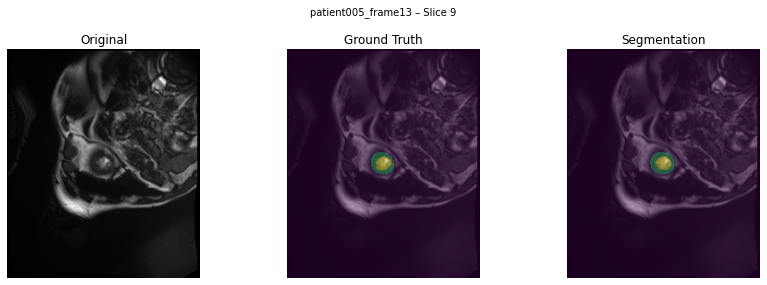

In [29]:
for path in patient_ids:
    img     = all_images[path]          
    gt      = all_labels[path]          
    result  = all_segmentations[path]
    
    for slide in range(img.shape[0]):
        plt.figure(figsize=(12, 4))

        # Original
        plt.subplot(1, 3, 1)
        plt.imshow(img[slide], cmap="gray")
        plt.title("Original")
        plt.axis("off")

        # Ground truth
        plt.subplot(1, 3, 2)
        plt.imshow(img[slide], cmap="gray")
        plt.imshow(gt[slide], alpha=0.4)
        plt.title("Ground Truth")
        plt.axis("off")

        # Segmentation
        plt.subplot(1, 3, 3)
        plt.imshow(img[slide], cmap="gray")
        plt.imshow(result[slide], alpha=0.4)
        plt.title("Segmentation")
        plt.axis("off")

        plt.suptitle(f"{path} – Slice {slide}", fontsize=10)
        plt.tight_layout()
        plt.show()
        
all_predictions = {}
all_segmentations = {}




▶ patient001_frame01


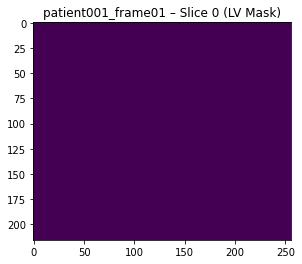

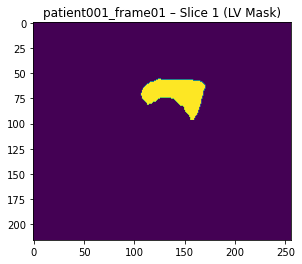

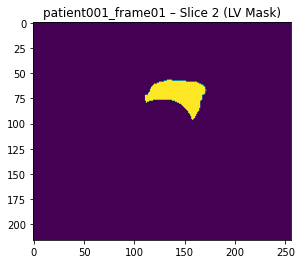

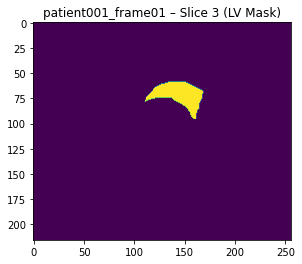

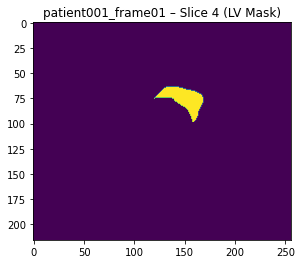

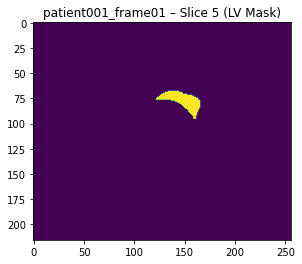

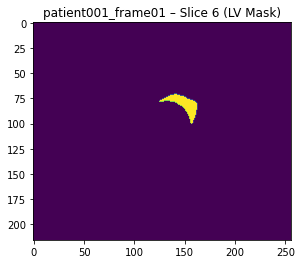

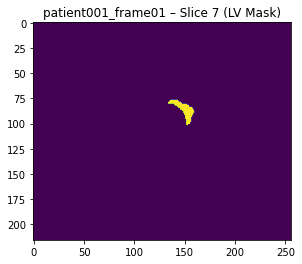

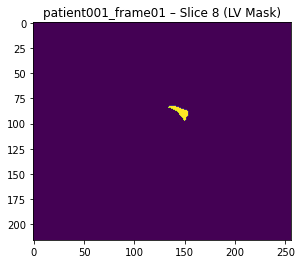

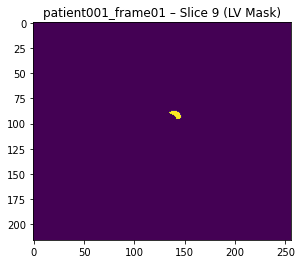


▶ patient001_frame12


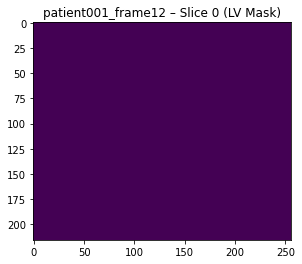

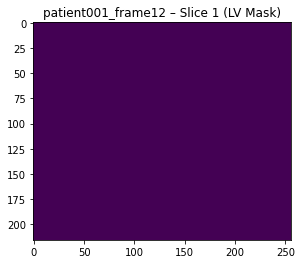

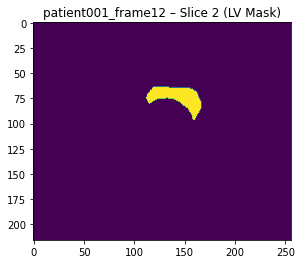

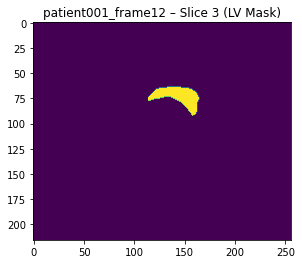

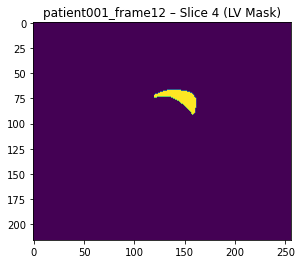

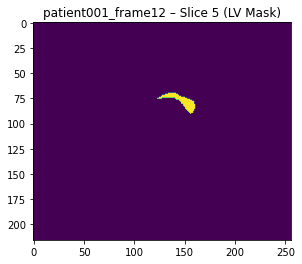

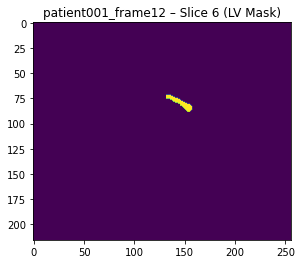

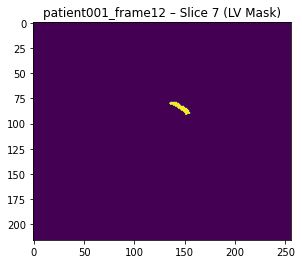

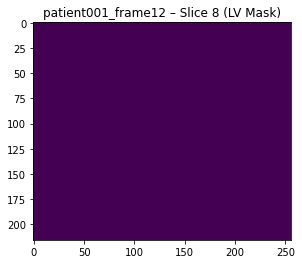

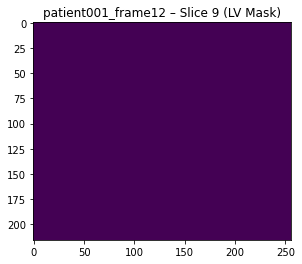


▶ patient002_frame01


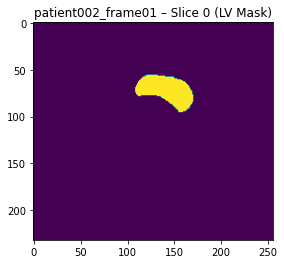

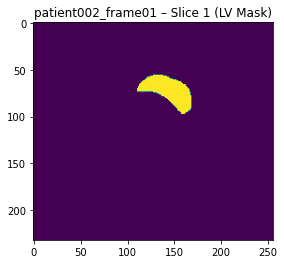

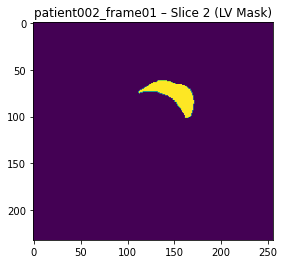

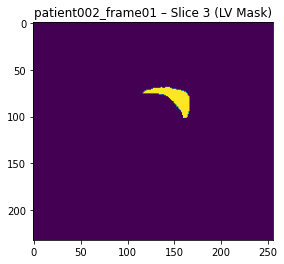

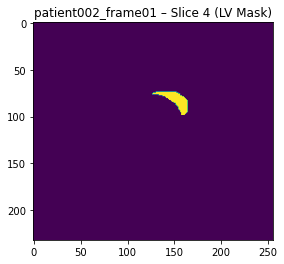

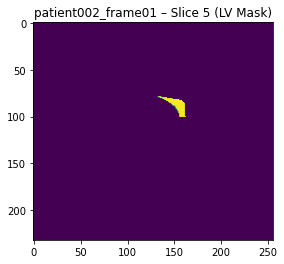

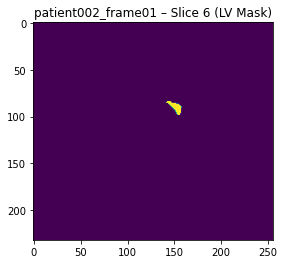

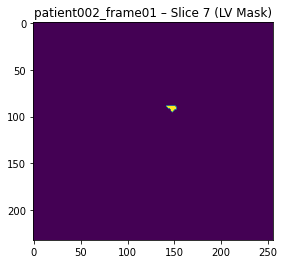

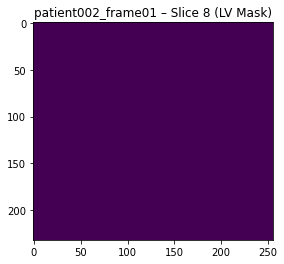

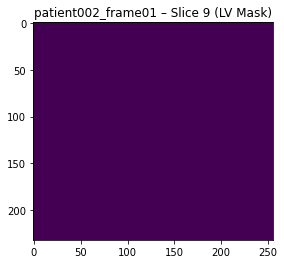


▶ patient002_frame12


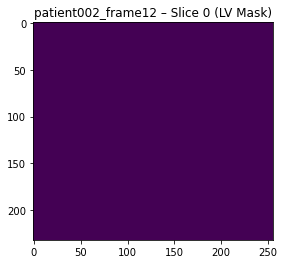

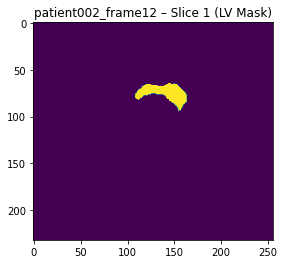

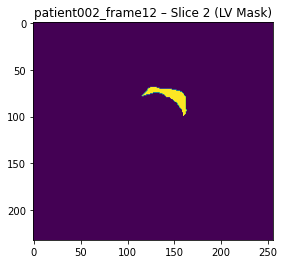

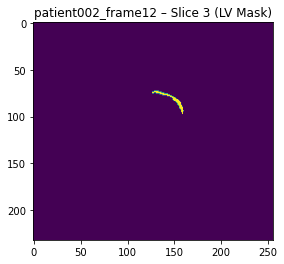

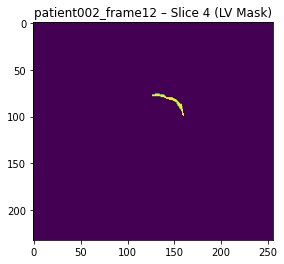

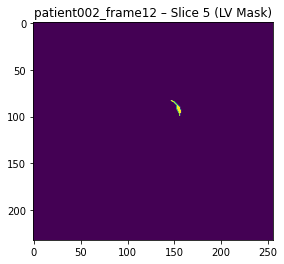

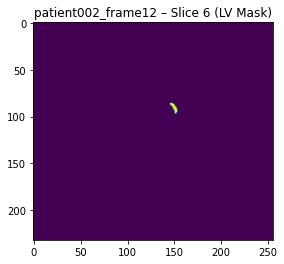

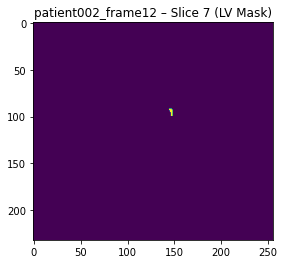

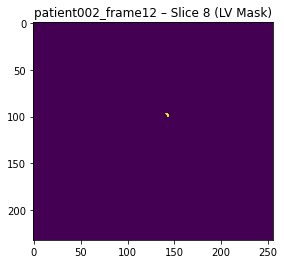

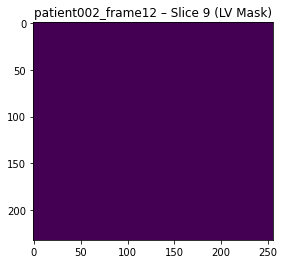


▶ patient003_frame01


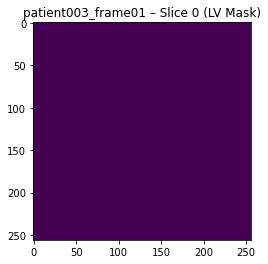

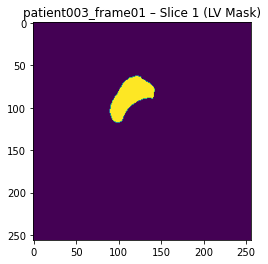

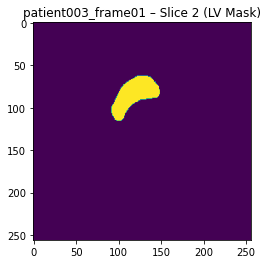

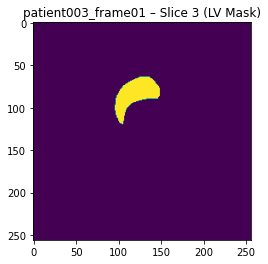

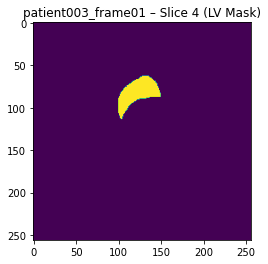

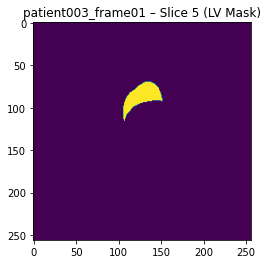

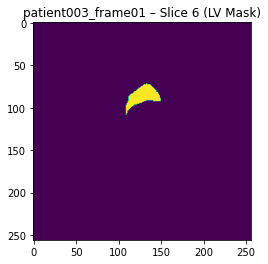

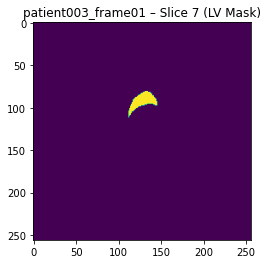

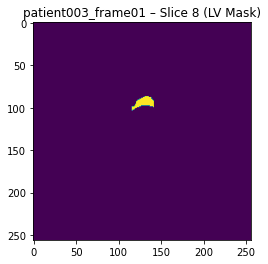

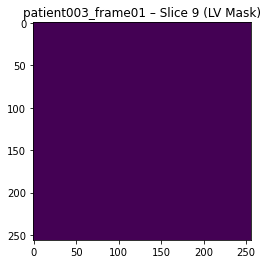


▶ patient003_frame15


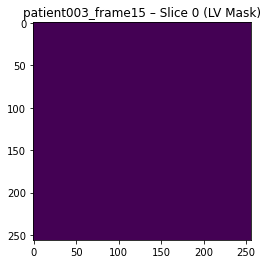

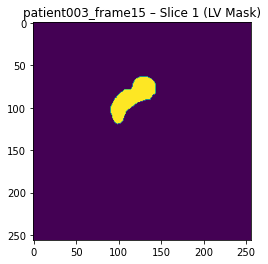

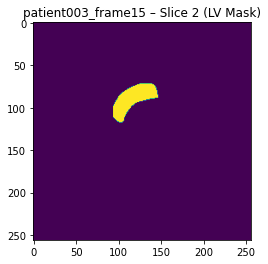

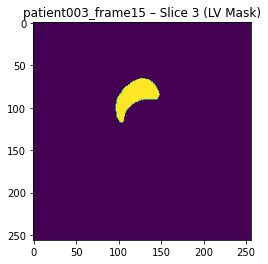

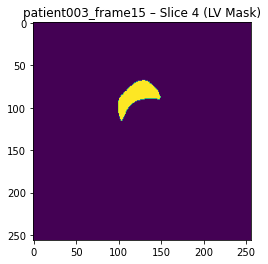

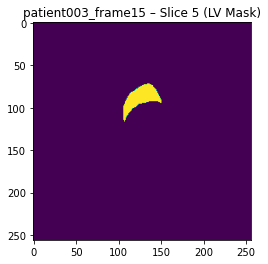

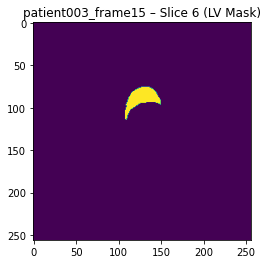

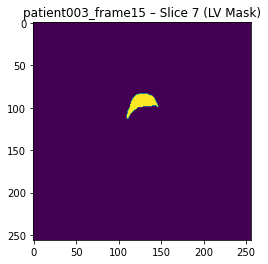

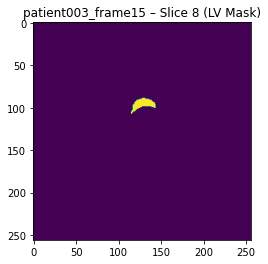

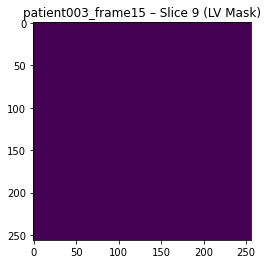


▶ patient004_frame01


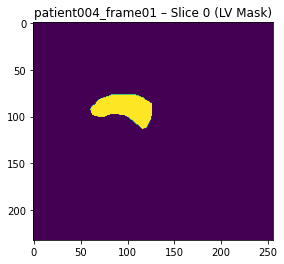

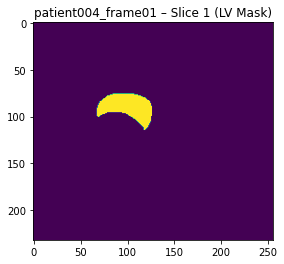

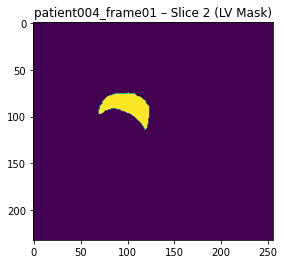

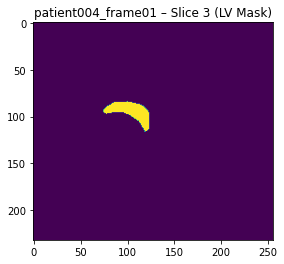

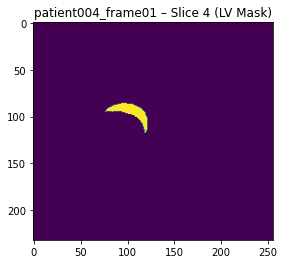

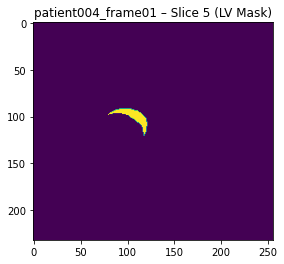

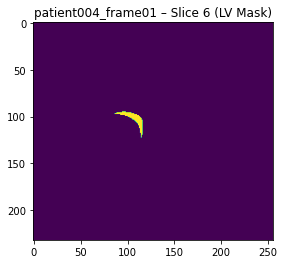

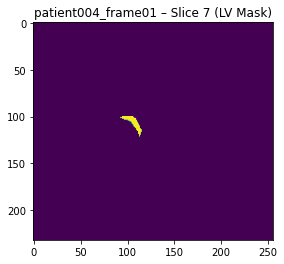

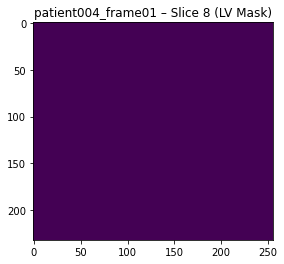

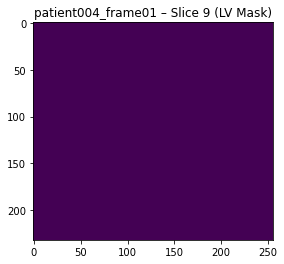


▶ patient004_frame15


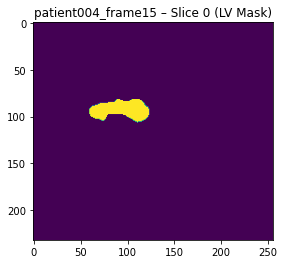

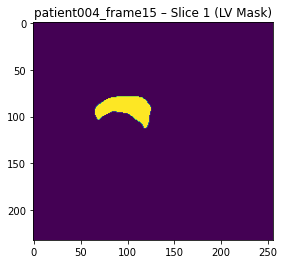

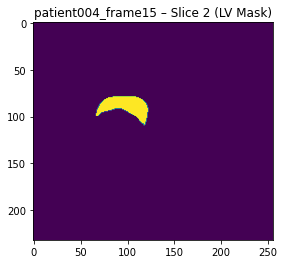

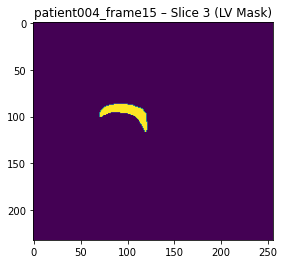

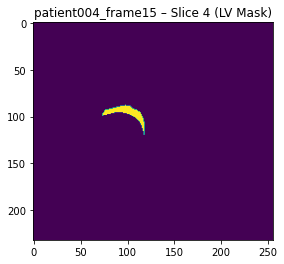

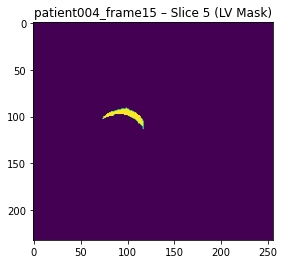

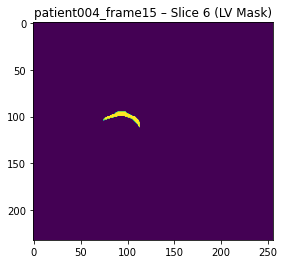

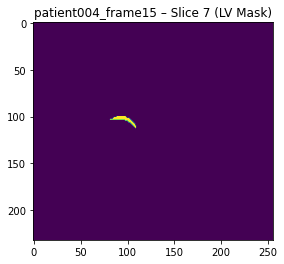

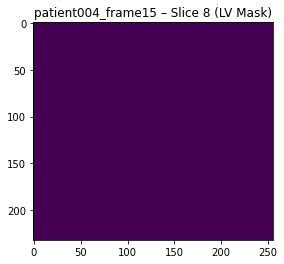

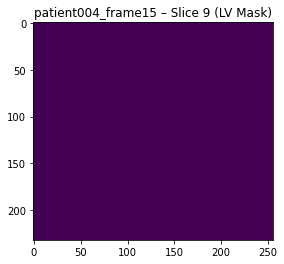


▶ patient005_frame01


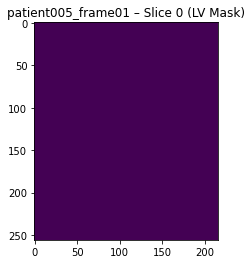

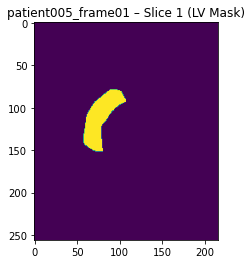

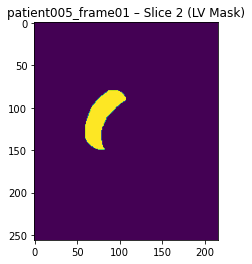

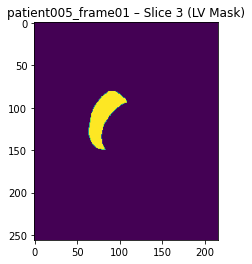

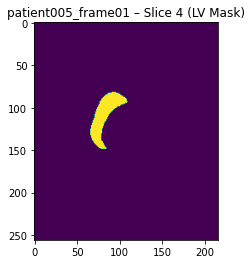

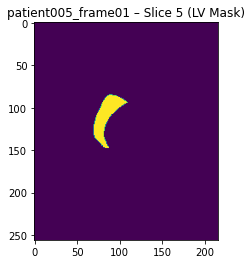

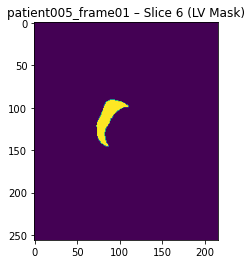

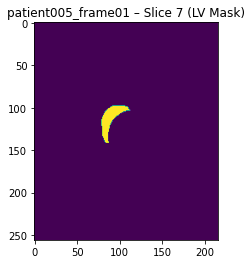

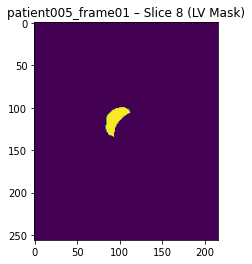

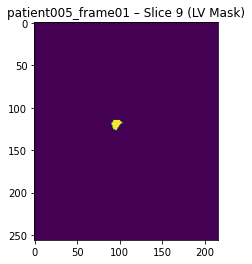


▶ patient005_frame13


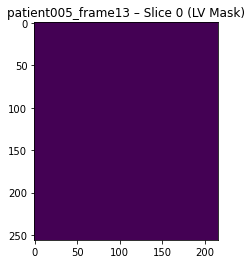

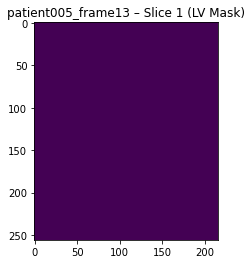

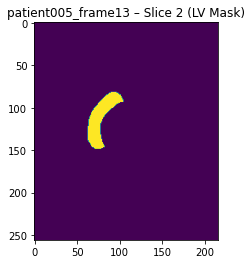

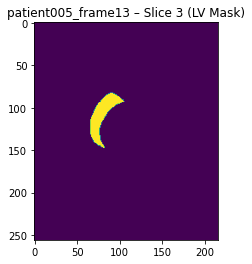

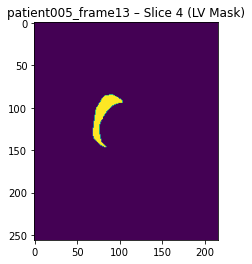

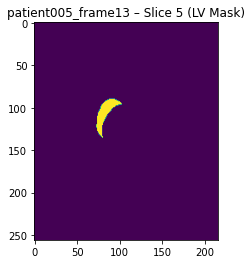

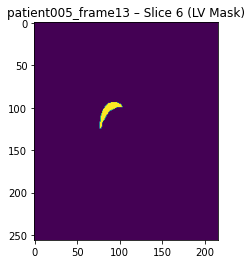

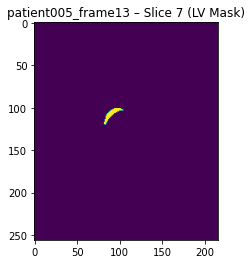

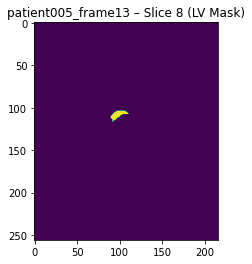

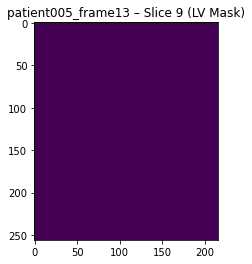

In [30]:
#Right ventricle cavity (RV)
for path in patient_ids:
    print(f"\n▶ {path}")
    img = all_images[path]   
    gt  = all_labels[path]   

    mask = np.zeros_like(img)
    indices = np.where(gt == 1)
    mask[indices] = 1

    for slide in range(img.shape[0]):
        plt.imshow(mask[slide])
        plt.title(f"{path} – Slice {slide} (RV Mask)")
        plt.show()

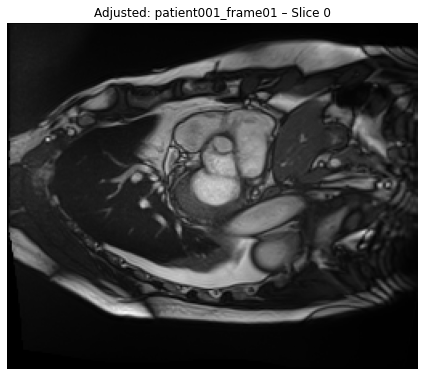

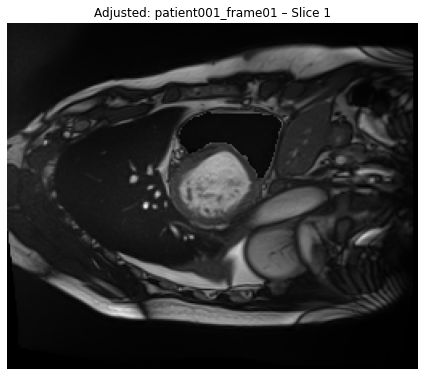

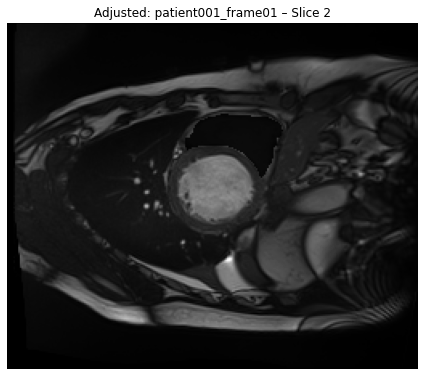

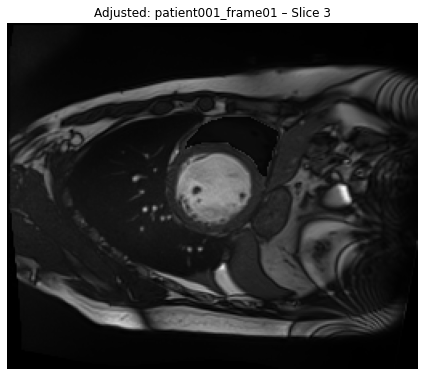

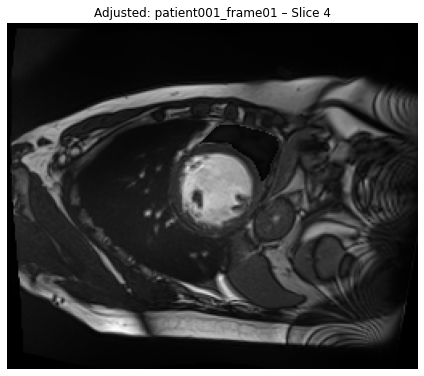

...

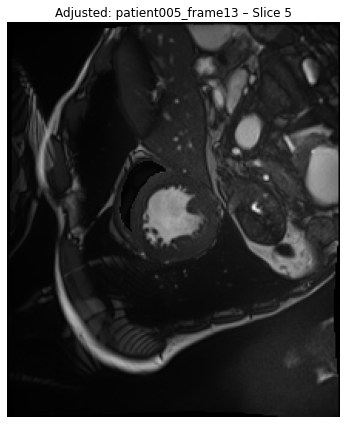

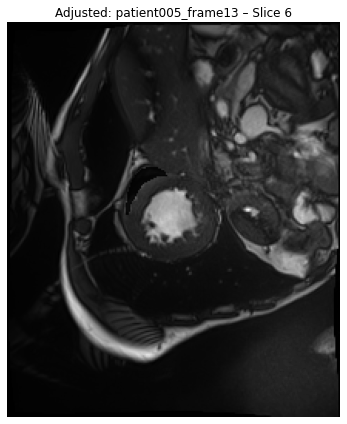

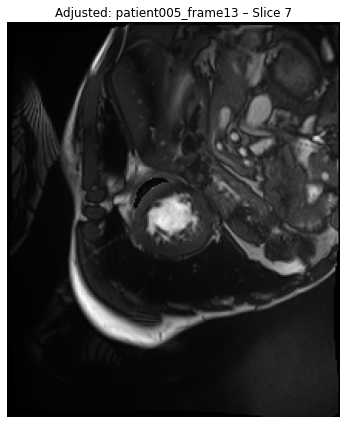

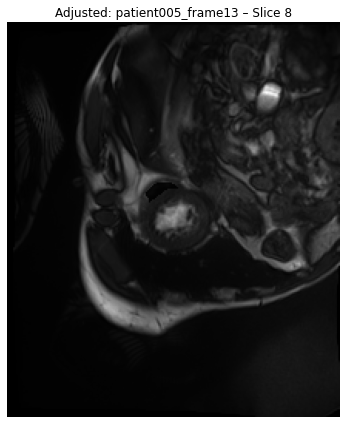

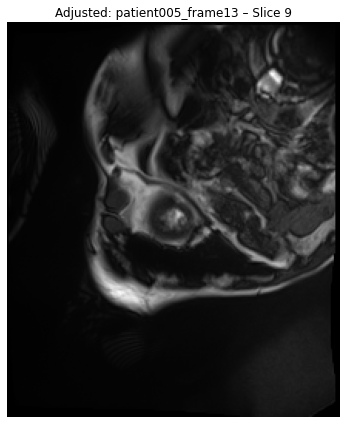

In [37]:
s = 0.1
for path in patient_ids:
    img = all_images[path]
    gt  = all_labels[path]
    style_adjusted_input = img.copy().astype(np.float32)
    indices = np.where(gt == 1)
    style_adjusted_input[indices] *= s
    for slide in range(style_adjusted_input.shape[0]):
        plt.figure(figsize=(6,6))
        plt.imshow(style_adjusted_input[slide], cmap="gray")
        plt.title(f"Adjusted: {path} – Slice {slide}")
        plt.axis("off")
        plt.tight_layout()
        plt.show()


In [34]:
all_predictions = {}
all_segmentations = {}

for path in patient_ids:
    print(f"\n▶ Performing segmentation for: {path}")

    img = all_images[path]  # already transposed to (slices, H, W)

    # perform segmentation
    pred = model.predict(img)  # shape: (slices, classes, H, W)
    print(np.shape(pred))

    result = np.argmax(pred, axis=1)  # shape: (slices, H, W)
    print(np.shape(result))

    all_predictions[path] = pred
    all_segmentations[path] = result



▶ Performing segmentation for: patient001_frame01
(10, 4, 216, 256)
(10, 216, 256)

▶ Performing segmentation for: patient001_frame12
(10, 4, 216, 256)
(10, 216, 256)

▶ Performing segmentation for: patient002_frame01
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient002_frame12
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient003_frame01
(10, 4, 256, 256)
(10, 256, 256)

▶ Performing segmentation for: patient003_frame15
(10, 4, 256, 256)
(10, 256, 256)

▶ Performing segmentation for: patient004_frame01
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient004_frame15
(10, 4, 232, 256)
(10, 232, 256)

▶ Performing segmentation for: patient005_frame01
(10, 4, 256, 216)
(10, 256, 216)

▶ Performing segmentation for: patient005_frame13
(10, 4, 256, 216)
(10, 256, 216)


In [36]:

target_layers = [
    "0.conv.unit0.adn.N",
    "0.conv.unit1.adn.N",
    "0.conv.unit2.adn.N",
    "0.conv.unit3.adn.N",
    "1.submodule.0.conv.unit0.adn.N",
    "1.submodule.0.conv.unit1.adn.N",
    "1.submodule.0.conv.unit2.adn.N",
    "1.submodule.0.conv.unit3.adn.N",
    "1.submodule.1.submodule.0.conv.unit0.adn.N",
    "1.submodule.1.submodule.0.conv.unit1.adn.N",
    "1.submodule.1.submodule.0.conv.unit2.adn.N",
    "1.submodule.1.submodule.0.conv.unit3.adn.N",
    "1.submodule.1.submodule.1.submodule.0.conv.unit0.adn.N",
    "1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N",
    "1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N",
    "1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N",
    "1.submodule.1.submodule.2.0.adn.N",
    "1.submodule.1.submodule.2.1.conv.unit0.adn.N",
    "1.submodule.2.0.adn.N",
    "1.submodule.2.1.conv.unit0.adn.N",
    "2.0.adn.N"
]

In [61]:
for path in patient_ids:
    features_orig_dict  = [dict() for _ in range(10)]
    features_bright_dict = [dict() for _ in range(10)]
    img_bright = style_adjusted_input.copy()

    def get_hook(name, storage_dict):
        def hook_fn(module, inp, out):
            storage_dict[name] = out.detach().cpu()
        return hook_fn

    for i in range(10):                                
        handles = []
        for name in target_layers:
            module = dict(model.model.model.named_modules())[name]
            handles.append(module.register_forward_hook(
                get_hook(name, features_orig_dict[i])))

        _ = model.predict(img[i][None])                    

        for h in handles:                                  
            h.remove()

        handles = []
        for name in target_layers:
            module = dict(model.model.model.named_modules())[name]
            handles.append(module.register_forward_hook(
                get_hook(name, features_bright_dict[i])))

        _ = model.predict(img_bright[i][None])             

        for h in handles:
            h.remove()

In [62]:
for path in patient_ids:
    for i in range(10):
        print(f"\n🧠 Slice {i}")
        for layer_name, tensor in features_orig_dict[i].items():
            channels = tensor.shape[1]
            print(f" {path} {layer_name}: {channels} channels")



🧠 Slice 0
 patient001_frame01 0.conv.unit0.adn.N: 8 channels
 patient001_frame01 0.conv.unit1.adn.N: 8 channels
 patient001_frame01 0.conv.unit2.adn.N: 8 channels
 patient001_frame01 0.conv.unit3.adn.N: 8 channels
 patient001_frame01 1.submodule.0.conv.unit0.adn.N: 16 channels
 patient001_frame01 1.submodule.0.conv.unit1.adn.N: 16 channels
 patient001_frame01 1.submodule.0.conv.unit2.adn.N: 16 channels
 patient001_frame01 1.submodule.0.conv.unit3.adn.N: 16 channels
 patient001_frame01 1.submodule.1.submodule.0.conv.unit0.adn.N: 32 channels
 patient001_frame01 1.submodule.1.submodule.0.conv.unit1.adn.N: 32 channels
 patient001_frame01 1.submodule.1.submodule.0.conv.unit2.adn.N: 32 channels
 patient001_frame01 1.submodule.1.submodule.0.conv.unit3.adn.N: 32 channels
 patient001_frame01 1.submodule.1.submodule.1.submodule.0.conv.unit0.adn.N: 64 channels
 patient001_frame01 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N: 64 channels
 patient001_frame01 1.submodule.1.submodule.1.sub

 patient003_frame15 1.submodule.0.conv.unit2.adn.N: 16 channels
 patient003_frame15 1.submodule.0.conv.unit3.adn.N: 16 channels
 patient003_frame15 1.submodule.1.submodule.0.conv.unit0.adn.N: 32 channels
 patient003_frame15 1.submodule.1.submodule.0.conv.unit1.adn.N: 32 channels
 patient003_frame15 1.submodule.1.submodule.0.conv.unit2.adn.N: 32 channels
 patient003_frame15 1.submodule.1.submodule.0.conv.unit3.adn.N: 32 channels
 patient003_frame15 1.submodule.1.submodule.1.submodule.0.conv.unit0.adn.N: 64 channels
 patient003_frame15 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N: 64 channels
 patient003_frame15 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N: 64 channels
 patient003_frame15 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N: 64 channels
 patient003_frame15 1.submodule.1.submodule.2.0.adn.N: 16 channels
 patient003_frame15 1.submodule.1.submodule.2.1.conv.unit0.adn.N: 16 channels
 patient003_frame15 1.submodule.2.0.adn.N: 8 channels
 patient003_frame

 patient005_frame13 1.submodule.1.submodule.1.submodule.0.conv.unit0.adn.N: 64 channels
 patient005_frame13 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N: 64 channels
 patient005_frame13 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N: 64 channels
 patient005_frame13 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N: 64 channels
 patient005_frame13 1.submodule.1.submodule.2.0.adn.N: 16 channels
 patient005_frame13 1.submodule.1.submodule.2.1.conv.unit0.adn.N: 16 channels
 patient005_frame13 1.submodule.2.0.adn.N: 8 channels
 patient005_frame13 1.submodule.2.1.conv.unit0.adn.N: 8 channels
 patient005_frame13 2.0.adn.N: 4 channels

🧠 Slice 9
 patient005_frame13 0.conv.unit0.adn.N: 8 channels
 patient005_frame13 0.conv.unit1.adn.N: 8 channels
 patient005_frame13 0.conv.unit2.adn.N: 8 channels
 patient005_frame13 0.conv.unit3.adn.N: 8 channels
 patient005_frame13 1.submodule.0.conv.unit0.adn.N: 16 channels
 patient005_frame13 1.submodule.0.conv.unit1.adn.N: 16 channels

In [63]:

for path in patient_ids:
    # Loop over all slices and all layers
    for i in range(10):
        print(f"\n######## Slice {i} ########")

        for layer_name in target_layers:
            fmap_orig   = features_orig_dict[i][layer_name]     # (1, C, H, W)
            fmap_bright = features_bright_dict[i][layer_name]   # (1, C, H, W)

            num_channels = fmap_orig.shape[1]
            print(f"\n=== Layer: {layer_name} | Channels: {num_channels} ===")

            for ch in range(num_channels):
                orig   = fmap_orig[0, ch].numpy()
                bright = fmap_bright[0, ch].numpy()

                orig_n   = (orig - orig.min()) / (orig.max() - orig.min() + 1e-8)
                bright_n = (bright - bright.min()) / (bright.max() - bright.min() + 1e-8)

                mad  = np.mean(np.abs(orig - bright))
                mse  = np.mean((orig - bright) ** 2)
                ssim_val = ssim(orig_n, bright_n, data_range=1)

                print(f"{path} | Slice {i} | {layer_name} | Ch {ch:02d} → MAD={mad:.4f}, MSE={mse:.4f}, SSIM={ssim_val:.4f}")



######## Slice 0 ########

=== Layer: 0.conv.unit0.adn.N | Channels: 8 ===
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 00 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 01 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 02 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 03 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 04 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 05 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 06 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 0.conv.unit0.adn.N | Ch 07 → MAD=0.0000, MSE=0.0000, SSIM=1.0000

=== Layer: 0.conv.unit1.adn.N | Channels: 8 ===
patient001_frame01 | Slice 0 | 0.conv.unit1.adn.N | Ch 00 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_

patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 14 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 15 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 16 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 17 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 18 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 19 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 20 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 21 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodu

patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 31 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 32 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 33 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 34 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 35 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 36 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 37 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 00 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 01 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 02 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 03 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 04 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 05 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 06 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 0 | 1.submodule.2.1.conv.unit0.adn.N | Ch 07 → MAD=0.0000, MSE=0.0000, SSIM=1.0000

=== Layer: 2.0.adn.N | Channels: 4 ===
patient001_frame01 | Slice 0 | 2.0.adn.N | Ch 00 → MAD=0.0000, MSE=0.0000, SSIM=

patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 03 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 04 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 05 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 06 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 07 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 08 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 09 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 10 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.0.conv.unit2.adn.N | Ch 11 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1

patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 10 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 11 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 12 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 13 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 14 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 15 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 16 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 17 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodu

patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 33 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 34 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 35 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 36 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 37 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 38 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 39 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 03 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 04 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 05 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 06 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 07 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 08 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 09 → MAD=0.0000, MSE=0.0000, SSIM=1.0000
patient001_frame01 | Slice 1 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 2 | 0.conv.unit2.adn.N | Ch 01 → MAD=0.0416, MSE=0.0598, SSIM=0.9795
patient001_frame01 | Slice 2 | 0.conv.unit2.adn.N | Ch 02 → MAD=0.0286, MSE=0.0320, SSIM=0.9829
patient001_frame01 | Slice 2 | 0.conv.unit2.adn.N | Ch 03 → MAD=0.0398, MSE=0.0380, SSIM=0.9829
patient001_frame01 | Slice 2 | 0.conv.unit2.adn.N | Ch 04 → MAD=0.0315, MSE=0.0382, SSIM=0.9850
patient001_frame01 | Slice 2 | 0.conv.unit2.adn.N | Ch 05 → MAD=0.0462, MSE=0.0531, SSIM=0.9799
patient001_frame01 | Slice 2 | 0.conv.unit2.adn.N | Ch 06 → MAD=0.0556, MSE=0.0662, SSIM=0.9741
patient001_frame01 | Slice 2 | 0.conv.unit2.adn.N | Ch 07 → MAD=0.0365, MSE=0.0352, SSIM=0.9853

=== Layer: 0.conv.unit3.adn.N | Channels: 8 ===
patient001_frame01 | Slice 2 | 0.conv.unit3.adn.N | Ch 00 → MAD=0.0410, MSE=0.0337, SSIM=0.9839
patient001_frame01 | Slice 2 | 0.conv.unit3.adn.N | Ch 01 → MAD=0.0427, MSE=0.0348, SSIM=0.9838
patient001_frame01 | Slice 2 | 0.conv.unit3.adn.N | Ch 02 → MAD=0.0609, MSE=0.0663, SSI

patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 21 → MAD=0.1254, MSE=0.1789, SSIM=0.8956
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 22 → MAD=0.0699, MSE=0.0475, SSIM=0.9699
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 23 → MAD=0.1036, MSE=0.1198, SSIM=0.9376
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 24 → MAD=0.0780, MSE=0.0795, SSIM=0.9552
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 25 → MAD=0.0564, MSE=0.0326, SSIM=0.9796
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 26 → MAD=0.0874, MSE=0.0935, SSIM=0.9365
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 27 → MAD=0.0667, MSE=0.0600, SSIM=0.9658
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 28 → MAD=0.0711, MSE=0.0449, SSIM=0.9613
patient001_frame01 | Slice 2 | 1.submodu

patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 56 → MAD=0.1123, MSE=0.0726, SSIM=0.9633
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 57 → MAD=0.0805, MSE=0.0474, SSIM=0.9784
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 58 → MAD=0.0973, MSE=0.0572, SSIM=0.9581
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 59 → MAD=0.1328, MSE=0.0855, SSIM=0.9087
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 60 → MAD=0.1277, MSE=0.0804, SSIM=0.9310
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 61 → MAD=0.1131, MSE=0.0847, SSIM=0.9632
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 62 → MAD=0.1017, MSE=0.0729, SSIM=0.9610
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 39 → MAD=0.2735, MSE=0.3268, SSIM=0.8542
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 40 → MAD=0.1859, MSE=0.1573, SSIM=0.8942
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 41 → MAD=0.2363, MSE=0.2916, SSIM=0.8053
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 42 → MAD=0.2097, MSE=0.2257, SSIM=0.9062
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 43 → MAD=0.3285, MSE=0.5862, SSIM=0.7490
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 44 → MAD=0.2456, MSE=0.2252, SSIM=0.7933
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 45 → MAD=0.1861, MSE=0.2082, SSIM=0.9388
patient001_frame01 | Slice 2 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 00 → MAD=0.0355, MSE=0.0542, SSIM=0.9751
patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 01 → MAD=0.0500, MSE=0.0615, SSIM=0.9708
patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 02 → MAD=0.0384, MSE=0.0753, SSIM=0.9759
patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 03 → MAD=0.0269, MSE=0.0521, SSIM=0.9813
patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 04 → MAD=0.0378, MSE=0.0618, SSIM=0.9797
patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 05 → MAD=0.0351, MSE=0.0666, SSIM=0.9804
patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 06 → MAD=0.0414, MSE=0.0636, SSIM=0.9811
patient001_frame01 | Slice 3 | 0.conv.unit1.adn.N | Ch 07 → MAD=0.0393, MSE=0.0580, SSIM=0.9761

=== Layer: 0.conv.unit2.adn.N | Channels: 8 ===
patient001_frame01 | Slice 3 | 0.conv.unit2.adn.N | Ch 00 → MAD=0.0394, MSE=0.0533, SSIM=0.9747
patient001_frame01 | Slice 3 | 0.conv.unit2.adn.N | Ch 01 → MAD=0.0415, MSE=0.0667, SSI

patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 20 → MAD=0.0630, MSE=0.0517, SSIM=0.9603
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 21 → MAD=0.0833, MSE=0.1019, SSIM=0.9256
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 22 → MAD=0.0657, MSE=0.0592, SSIM=0.9618
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 23 → MAD=0.0789, MSE=0.0862, SSIM=0.9480
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 24 → MAD=0.0667, MSE=0.0557, SSIM=0.9610
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 25 → MAD=0.0454, MSE=0.0242, SSIM=0.9850
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 26 → MAD=0.0704, MSE=0.0769, SSIM=0.9428
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 27 → MAD=0.0645, MSE=0.0568, SSIM=0.9657
patient001_frame01 | Slice 3 | 1.submodu

patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 51 → MAD=0.0856, MSE=0.0480, SSIM=0.9720
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 52 → MAD=0.0754, MSE=0.0417, SSIM=0.9595
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 53 → MAD=0.0917, MSE=0.0646, SSIM=0.9375
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 54 → MAD=0.0812, MSE=0.0411, SSIM=0.9650
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 55 → MAD=0.0823, MSE=0.0406, SSIM=0.9747
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 56 → MAD=0.0991, MSE=0.0641, SSIM=0.9661
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 57 → MAD=0.0807, MSE=0.0632, SSIM=0.9619
patient001_frame01 | Slice 3 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 3 | 1.submodule.2.1.conv.unit0.adn.N | Ch 02 → MAD=0.1208, MSE=0.0806, SSIM=0.7773
patient001_frame01 | Slice 3 | 1.submodule.2.1.conv.unit0.adn.N | Ch 03 → MAD=0.1159, MSE=0.0551, SSIM=0.9391
patient001_frame01 | Slice 3 | 1.submodule.2.1.conv.unit0.adn.N | Ch 04 → MAD=0.1771, MSE=0.1909, SSIM=0.9208
patient001_frame01 | Slice 3 | 1.submodule.2.1.conv.unit0.adn.N | Ch 05 → MAD=0.1167, MSE=0.1019, SSIM=0.9668
patient001_frame01 | Slice 3 | 1.submodule.2.1.conv.unit0.adn.N | Ch 06 → MAD=0.1223, MSE=0.0569, SSIM=0.8561
patient001_frame01 | Slice 3 | 1.submodule.2.1.conv.unit0.adn.N | Ch 07 → MAD=0.1110, MSE=0.0815, SSIM=0.9750

=== Layer: 2.0.adn.N | Channels: 4 ===
patient001_frame01 | Slice 3 | 2.0.adn.N | Ch 00 → MAD=0.1368, MSE=0.1073, SSIM=0.9408
patient001_frame01 | Slice 3 | 2.0.adn.N | Ch 01 → MAD=0.0843, MSE=0.0233, SSIM=0.9830
patient001_frame01 | Slice 3 | 2.0.adn.N | Ch 02 → MAD=0.0648, MSE=0.0300, SSIM=0.9908
patient001_frame01 | Slice 3 | 2.0.adn.

patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 06 → MAD=0.0540, MSE=0.0679, SSIM=0.9512
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 07 → MAD=0.0398, MSE=0.0353, SSIM=0.9761
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 08 → MAD=0.0430, MSE=0.0283, SSIM=0.9695
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 09 → MAD=0.0400, MSE=0.0357, SSIM=0.9742
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 10 → MAD=0.0332, MSE=0.0225, SSIM=0.9834
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 11 → MAD=0.0331, MSE=0.0199, SSIM=0.9837
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 12 → MAD=0.0427, MSE=0.0385, SSIM=0.9769
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 13 → MAD=0.0482, MSE=0.0527, SSIM=0.9618
patient001_frame01 | Slice 4 | 1.submodu

patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 13 → MAD=0.0658, MSE=0.0287, SSIM=0.9756
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 14 → MAD=0.1082, MSE=0.0511, SSIM=0.9779
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 15 → MAD=0.0627, MSE=0.0275, SSIM=0.9767
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 16 → MAD=0.0787, MSE=0.0543, SSIM=0.9654
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 17 → MAD=0.0922, MSE=0.0914, SSIM=0.9388
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 18 → MAD=0.0589, MSE=0.0291, SSIM=0.9661
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 19 → MAD=0.0678, MSE=0.0346, SSIM=0.9717
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 4 | 1.submodule.1.submodule.1.submodule.0.conv.unit3.adn.N | Ch 63 → MAD=0.1062, MSE=0.0467, SSIM=0.9646

=== Layer: 1.submodule.1.submodule.2.0.adn.N | Channels: 16 ===
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.2.0.adn.N | Ch 00 → MAD=0.0826, MSE=0.0666, SSIM=0.9707
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.2.0.adn.N | Ch 01 → MAD=0.0742, MSE=0.0425, SSIM=0.9771
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.2.0.adn.N | Ch 02 → MAD=0.1063, MSE=0.0686, SSIM=0.9710
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.2.0.adn.N | Ch 03 → MAD=0.0728, MSE=0.0533, SSIM=0.9845
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.2.0.adn.N | Ch 04 → MAD=0.0803, MSE=0.0518, SSIM=0.9769
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.2.0.adn.N | Ch 05 → MAD=0.1155, MSE=0.0766, SSIM=0.9665
patient001_frame01 | Slice 4 | 1.submodule.1.submodule.2.0.adn.N | Ch 06 → MAD=0.1098, MSE=0.0790, SSIM=0.9344
patient001_frame01 | Slice

patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 26 → MAD=0.0295, MSE=0.0205, SSIM=0.9809
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 27 → MAD=0.0326, MSE=0.0217, SSIM=0.9840
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 28 → MAD=0.0338, MSE=0.0174, SSIM=0.9855
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 29 → MAD=0.0312, MSE=0.0181, SSIM=0.9868
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 30 → MAD=0.0474, MSE=0.0348, SSIM=0.9725
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit1.adn.N | Ch 31 → MAD=0.0467, MSE=0.0499, SSIM=0.9684

=== Layer: 1.submodule.1.submodule.0.conv.unit2.adn.N | Channels: 32 ===
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 00 → MAD=0.0304, MSE=0.0082, SSIM=0.9917
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 01 → MA

patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 00 → MAD=0.0668, MSE=0.0384, SSIM=0.9819
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 01 → MAD=0.0620, MSE=0.0328, SSIM=0.9756
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 02 → MAD=0.0657, MSE=0.0311, SSIM=0.9777
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 03 → MAD=0.0878, MSE=0.0530, SSIM=0.9671
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 04 → MAD=0.0526, MSE=0.0229, SSIM=0.9884
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 05 → MAD=0.0721, MSE=0.0429, SSIM=0.9714
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.unit2.adn.N | Ch 06 → MAD=0.0639, MSE=0.0356, SSIM=0.9636
patient001_frame01 | Slice 5 | 1.submodule.1.submodule.1.submodule.0.conv.un

patient001_frame01 | Slice 5 | 1.submodule.2.1.conv.unit0.adn.N | Ch 04 → MAD=0.0634, MSE=0.0459, SSIM=0.9783
patient001_frame01 | Slice 5 | 1.submodule.2.1.conv.unit0.adn.N | Ch 05 → MAD=0.0532, MSE=0.0309, SSIM=0.9862
patient001_frame01 | Slice 5 | 1.submodule.2.1.conv.unit0.adn.N | Ch 06 → MAD=0.0467, MSE=0.0105, SSIM=0.9548
patient001_frame01 | Slice 5 | 1.submodule.2.1.conv.unit0.adn.N | Ch 07 → MAD=0.0469, MSE=0.0198, SSIM=0.9897

=== Layer: 2.0.adn.N | Channels: 4 ===
patient001_frame01 | Slice 5 | 2.0.adn.N | Ch 00 → MAD=0.0513, MSE=0.0267, SSIM=0.9910
patient001_frame01 | Slice 5 | 2.0.adn.N | Ch 01 → MAD=0.0368, MSE=0.0101, SSIM=0.9945
patient001_frame01 | Slice 5 | 2.0.adn.N | Ch 02 → MAD=0.0279, MSE=0.0086, SSIM=0.9973
patient001_frame01 | Slice 5 | 2.0.adn.N | Ch 03 → MAD=0.0444, MSE=0.0213, SSIM=0.9963

######## Slice 6 ########

=== Layer: 0.conv.unit0.adn.N | Channels: 8 ===
patient001_frame01 | Slice 6 | 0.conv.unit0.adn.N | Ch 00 → MAD=0.0106, MSE=0.0304, SSIM=0.9925


patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 04 → MAD=0.0109, MSE=0.0030, SSIM=0.9936
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 05 → MAD=0.0141, MSE=0.0065, SSIM=0.9918
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 06 → MAD=0.0142, MSE=0.0054, SSIM=0.9940
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 07 → MAD=0.0108, MSE=0.0023, SSIM=0.9935
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 08 → MAD=0.0189, MSE=0.0107, SSIM=0.9929
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 09 → MAD=0.0129, MSE=0.0045, SSIM=0.9930
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 10 → MAD=0.0085, MSE=0.0017, SSIM=0.9926
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 11 → MAD=0.0140, MSE=0.0050, SSIM=0.9929
patient001_frame01 | Slice 6 | 1.submodule.0.conv.unit3.adn.N | Ch 12 → MAD=0.0150, MSE=0.0088, SSIM=0.9922
patient001_frame01 | Slice 6

patient001_frame01 | Slice 6 | 1.submodule.1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 17 → MAD=0.0276, MSE=0.0130, SSIM=0.9890
patient001_frame01 | Slice 6 | 1.submodule.1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 18 → MAD=0.0307, MSE=0.0161, SSIM=0.9908
patient001_frame01 | Slice 6 | 1.submodule.1.submodule.1.submodule.0.conv.unit0.adn.N | Ch 19 → MAD=0.0262, MSE=0.0064, SSIM=0.9941


KeyboardInterrupt: 

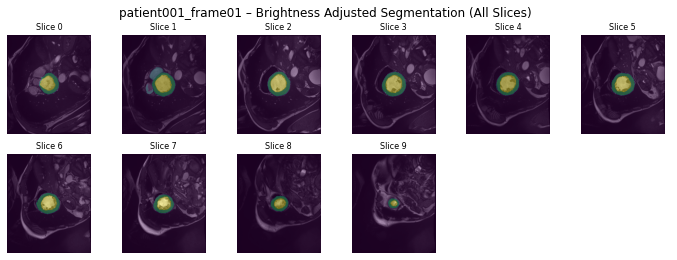

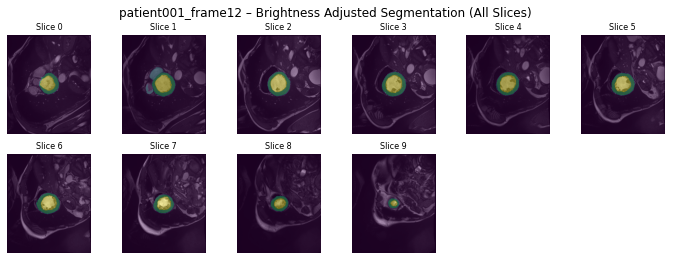

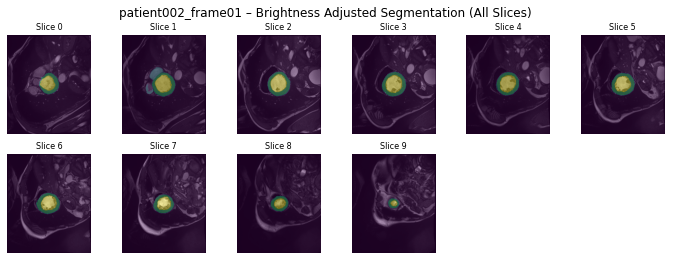

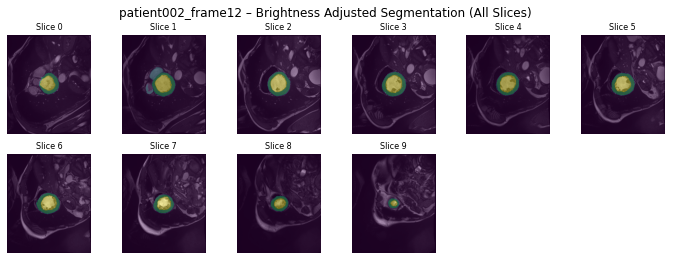

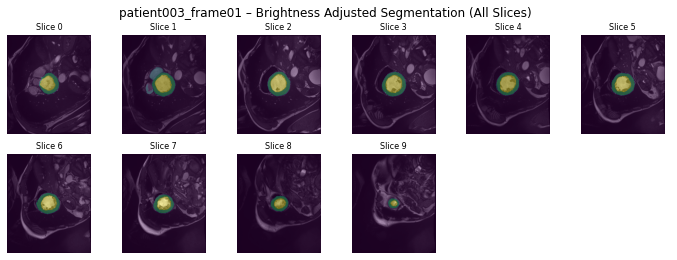

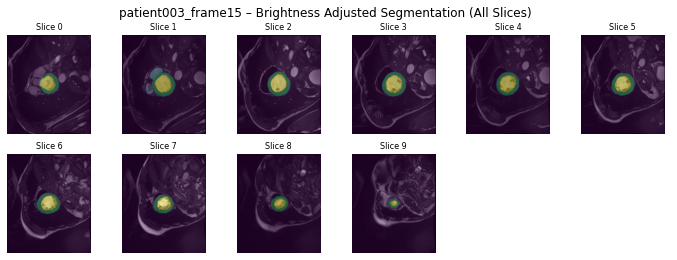

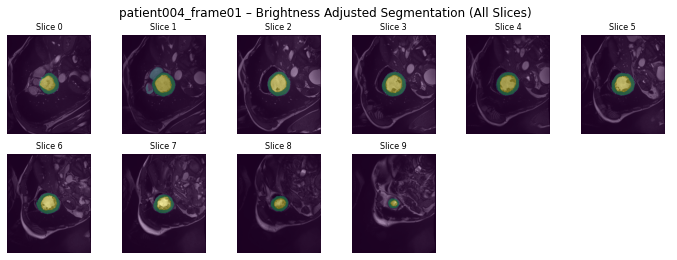

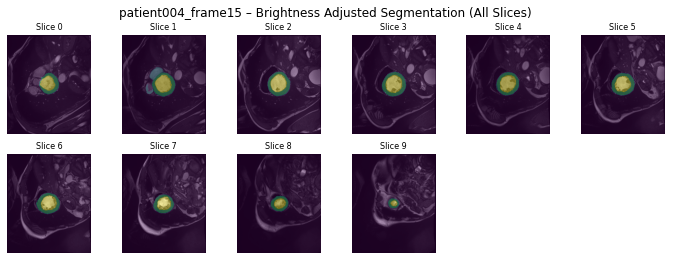

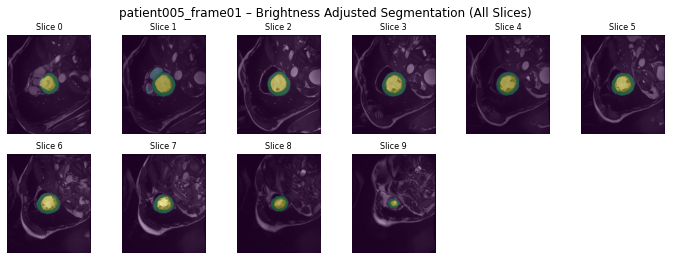

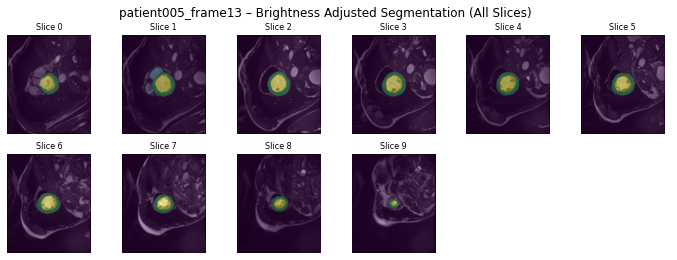

In [57]:
for path in patient_ids:

    # Predict on bright image
    pred_bright = model.predict(img_bright)         # (slices, classes, H, W)
    seg_bright = np.argmax(pred_bright, axis=1)     # (slices, H, W)

    num_slices = img_bright.shape[0]
    cols = 6
    rows = math.ceil(num_slices / cols)

    fig, axs = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axs = axs.flatten()

    for i in range(num_slices):
        axs[i].imshow(img_bright[i], cmap="gray")
        axs[i].imshow(seg_bright[i], alpha=0.4)
        axs[i].set_title(f"Slice {i}", fontsize=8)
        axs[i].axis("off")

    # Turn off any unused subplots
    for i in range(num_slices, len(axs)):
        axs[i].axis("off")

    fig.suptitle(f"{path} – Brightness Adjusted Segmentation (All Slices)", fontsize=12)
    
    plt.show()


In [59]:
channels_to_check = range(16)  # Adjust if needed

for layer_name in target_layers:
    fmap_orig = features_orig_dict[layer_name]
    fmap_bright = features_bright_dict[layer_name]

    num_slices = fmap_orig.shape[2]  # depth axis
    slices_to_check = range(num_slices)

    print(f"\n===== Layer: {layer_name} → Number of slices: {num_slices} =====")

    for ch in channels_to_check:
        for slice_idx in slices_to_check:
            orig = fmap_orig[0, ch, :, :].numpy()
            bright = fmap_bright[0, ch, :, :].numpy()

            orig_norm = (orig - orig.min()) / (orig.max() - orig.min() + 1e-8)
            bright_norm = (bright - bright.min()) / (bright.max() - bright.min() + 1e-8)

            abs_diff = np.abs(orig - bright)
            mad = np.mean(abs_diff)
            mse = np.mean((orig - bright) ** 2)
            ssim_val = ssim(orig_norm, bright_norm, data_range=1)

            print(f"Layer {layer_name} | Channel {ch} | Slice {slice_idx} → MAD={mad:.4f}, MSE={mse:.4f}, SSIM={ssim_val:.4f}")

            fig, axs = plt.subplots(1, 3, figsize=(12, 4))
            fig.suptitle(
                f"{layer_name} – Ch {ch}, Slice {slice_idx}\nMAD={mad:.4f} | MSE={mse:.4f} | SSIM={ssim_val:.4f}",
                fontsize=10
            )

            axs[0].imshow(orig, cmap="viridis")
            axs[0].set_title("Original")
            axs[0].axis("off")

            axs[1].imshow(bright, cmap="viridis")
            axs[1].set_title("Brightness Reduced")
            axs[1].axis("off")

            axs[2].imshow(abs_diff, cmap="magma")
            axs[2].set_title("Abs Diff")
            axs[2].axis("off")

            os.makedirs("slices_and_channels", exist_ok=True)
            out_path = f"slices_and_channels/layer_{layer_name.replace('.', '_')}_ch{ch}_slice{slice_idx}.png"
            plt.tight_layout()
            plt.savefig(out_path)
            plt.close()

TypeError: list indices must be integers or slices, not str

In [55]:
channels_to_check = range(16)
slice_idx = 5  

for layer_name in target_layers:
    fmap_orig = features_orig_dict[layer_name]
    fmap_bright = features_bright_dict[layer_name]

    print(f"\n===== Layer: {layer_name} =====")

    for ch in channels_to_check:
        orig = fmap_orig[0, ch, :, :].numpy()  
        bright = fmap_bright[0, ch, :, :].numpy()

        orig_norm = (orig - orig.min()) / (orig.max() - orig.min() + 1e-8)
        bright_norm = (bright - bright.min()) / (bright.max() - bright.min() + 1e-8)

        abs_diff = np.abs(orig - bright)
        mad = np.mean(abs_diff)
        mse = np.mean((orig - bright) ** 2)
        ssim_val = ssim(orig_norm, bright_norm, data_range=1)

        print(f"Channel {ch}: MAD={mad:.4f}, MSE={mse:.4f}, SSIM={ssim_val:.4f}")

        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        fig.suptitle(f"{layer_name} – Channel {ch}\nMAD={mad:.4f} | MSE={mse:.4f} | SSIM={ssim_val:.4f}", fontsize=10)

        axs[0].imshow(orig, cmap="viridis")
        axs[0].set_title("Original")
        axs[0].axis("off")

        axs[1].imshow(bright, cmap="viridis")
        axs[1].set_title("Brightness Reduced")
        axs[1].axis("off")

        axs[2].imshow(abs_diff, cmap="magma")
        axs[2].set_title("Abs Diff")
        axs[2].axis("off")

        os.makedirs("slices_and_channels", exist_ok=True)
        plt.tight_layout()
        out_path = f"slices_and_channels/layer_{layer_name.replace('.', '_')}_ch{ch}_slice{slice_idx}.png"
        plt.savefig(out_path)
        plt.close()

TypeError: list indices must be integers or slices, not str

In [ ]:
def dice_score(pred_mask, true_mask, class_id=3):
    pred_bin = (pred_mask == class_id).astype(np.uint8)
    true_bin = (true_mask == class_id).astype(np.uint8)

    intersection = np.sum(pred_bin * true_bin)
    total = np.sum(pred_bin) + np.sum(true_bin)

    return 1.0 if total == 0 else 2.0 * intersection / total

# --- Görselleştirme + Dice Skorları ---
for path in patient_ids:
    img     = all_images[path]          # (slices, H, W)
    gt      = all_labels[path]          # (slices, H, W)
    result  = all_segmentations[path]   # (slices, H, W)

    for slide in range(img.shape[0]):
        gt_slice = gt[slide]
        pred_slice = result[slide]

        # Boyut uyuşmazlığı varsa kırp
        if gt_slice.shape != pred_slice.shape:
            h = min(gt_slice.shape[0], pred_slice.shape[0])
            w = min(gt_slice.shape[1], pred_slice.shape[1])
            gt_slice = gt_slice[:h, :w]
            pred_slice = pred_slice[:h, :w]

        dice = dice_score(pred_slice, gt_slice, class_id=3)
        print(f"{path} – Slice {slide}: Dice Score = {dice:.4f}")

        # Görsel gösterim (opsiyonel)
        plt.figure(figsize=(12, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(img[slide], cmap="gray")
        plt.title("Original")
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(img[slide], cmap="gray")
        plt.imshow(gt_slice, alpha=0.4)
        plt.title("Ground Truth")
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(img[slide], cmap="gray")
        plt.imshow(pred_slice, alpha=0.4)
        plt.title("Segmentation")
        plt.axis("off")

        plt.suptitle(f"{path} – Slice {slide}", fontsize=10)
        plt.tight_layout()
        plt.show()


In [ ]:
def dice_score(pred_mask, true_mask, class_id=3):
    pred_bin = (pred_mask == class_id).astype(np.uint8)
    true_bin = (true_mask == class_id).astype(np.uint8)
    intersection = np.sum(pred_bin * true_bin)
    total = np.sum(pred_bin) + np.sum(true_bin)
    return 1.0 if total == 0 else 2.0 * intersection / total
